In [ ]:
# Importing required libraries
import numpy as np
import pandas as pd

import datetime as dt
import yfinance as yf
import pandas_datareader.data as web
import cpi
import wbdata
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, LSTM, Dropout, LeakyReLU
from sklearn.metrics import mean_squared_error

import matplotlib.pyplot as plt

import seaborn as sns
import pickle
import os
from scipy.stats import pearsonr


## Defining the dataset of monthly returns with macroeconomic indicators

In [5]:
# Define start and end dates 
start = dt.datetime(2005, 1, 1)
end = dt.datetime(2025, 5, 31)

In [6]:
# stocks we intend to look up 
sp500 = pd.read_csv('sp500_stocks.csv')

stock_list = sp500['Ticker'].values.tolist() + ['^GSPC']
sp500.set_index('Ticker', inplace=True)



In [7]:
# Find stocks where they have information since 2005
adj_close_data = {}

for stock in stock_list:
    data = yf.download(stock, start-pd.offsets.BDay(1), end+pd.offsets.BDay(1), auto_adjust=False)['Adj Close']
    first_date = data.index.min()
    if first_date.year <= 2005:
        adj_close_data[stock] = data[stock]


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%********

In [8]:
returns = pd.DataFrame(adj_close_data).pct_change().dropna()

# Dataframe with prices to help perform empirical bayesian modeling
last_price = pd.DataFrame(adj_close_data).iloc[-1].to_frame(name='Last_Price')
merged = last_price.merge(sp500, how='left', left_index=True, right_index=True)
# merged.to_csv('filtered_sp500_stocks.csv')
merged

,Last_Price,Company Name,Sector
AAPL,201.949997,Apple Inc.,Technology
MSFT,387.299988,Microsoft Corporation,Technology
NVDA,109.550003,NVIDIA Corporation,Technology
AMZN,181.649994,"Amazon.com, Inc.",Consumer Discretionary
GOOGL,158.869400,Alphabet Inc.,Communication Services
...,...,...,...
CRL,104.930000,"Charles River Laboratories International, Inc.",Healthcare
MHK,103.250000,"Mohawk Industries, Inc.",Consumer Discretionary
IVZ,12.835000,Invesco Ltd.,Financials
APA,14.860000,APA Corporation,Energy


In [9]:
# Getting a sense of the distribution of Companies in each Sector that are are analyzing
tickers = returns.columns.to_list() 
filtered = sp500.loc[sp500.index.intersection(tickers)]
filtered['Sector'].value_counts(normalize=True) 

Sector
Financials                0.141089
Industrials               0.141089
Technology                0.138614
Healthcare                0.131188
Consumer Discretionary    0.106436
Consumer Staples          0.076733
Real Estate               0.071782
Utilities                 0.069307
Energy                    0.042079
Materials                 0.042079
Communication Services    0.039604
Name: proportion, dtype: float64

In [10]:
# # customize seed for different stocks
# np.random.seed(42)

# # list of all potential stocks 
# ticker_list = ['AAPL','AXP', 'BAC', 'C', 'CSCO', 'GS', 'IBM', 'INTC', 'JPM', 'MSFT', 'NVDA', 'CRM', 'QCOM', 'NOW', 'ORCL', 'AVGO', 'GDDY',
#                'WIX', 'TSM', 'TSLA', 'SNOW', 'HUBS', 'DOCU', 'MS']

# # selecting 15 random stocks
# stock_list = np.random.choice(ticker_list,15,replace=False)
# stock_list = list(np.sort(stock_list))
# print(f'These are the fifteen stocks assigned to you: {" ".join(stock_list)}')

# defining start and end date
# start = dt.datetime(2005, 1, 1)
# end = dt.datetime(2025, 5, 31)

# getting returns of the stocks
# calculates returns using adjusted close price
# ensures that we have returns of only those dates where all companies have available information
# returns = yf.download(stock_list, start-pd.offsets.BDay(1), end+pd.offsets.BDay(1), auto_adjust=False)['Adj Close'].pct_change().dropna()


# S&P 500
# sp500 = yf.Ticker("^GSPC")
# sp500_data = sp500.history(period="25y")
# sp500_data['SP500'] = sp500_data['Close'].pct_change()
# sp500_data = sp500_data.drop(columns=["Open", "High", "Low", "Close", "Volume", "Dividends", "Stock Splits"])

# sp500_data.index = sp500_data.index.strftime('%m-%d-%Y')
# sp500_data.index = pd.to_datetime(sp500_data.index)
# sp500_mon = sp500_data.resample(rule = 'ME').apply(lambda x: x.add(1).prod().sub(1))

# returns = pd.merge(returns, sp500_data, left_index = True, right_index = True )


In [11]:
# Find finding monthly returns
returns.rename(columns ={'^GSPC':'SP500'}, inplace=True)
returns_mon = returns.resample(rule = 'ME').apply(lambda x: x.add(1).prod().sub(1))
# returns_mon

In [12]:
# # Standard deviation for 2005, January for SP500 to ensure that the standard deviation is correct. 
# sp500_stdev = returns.loc[(returns.index.year == 2005) & (returns.index.month == 1)]['SP500'].std()
# print(f"The standard deviation for SP500 in May of 2018 is {sp500_stdev}")

# Calculating STDEV for each month
monthly_std = returns.groupby(by=[returns.index.month, returns.index.year]).std()
monthly_std.index = pd.to_datetime(monthly_std.index.map(lambda x: f"{x[1]}-{x[0]}"), format="%Y-%m")
monthly_std.sort_index(inplace=True)
monthly_std.index = returns_mon.index

# monthly_std

In [13]:
# Ensure no value are missing
# monthly_std.isnull().sum().sort_values(ascending=False)
# monthly_std.to_csv('monthly_stdev.csv')

In [14]:
# Finding other features we care about 
# Finding risk free-rate
start = dt.datetime(2005, 1, 1)
end = dt.datetime(2025, 5, 31)

# Update on a quarterly basis no rf rate for 2025 
rf = web.DataReader('F-F_Research_Data_Factors','famafrench', start, end)[0][['RF']].div(100)
rf.index = rf.index.to_timestamp(how='end').normalize()

# CPI data from FRED
cpi = web.DataReader('CPIAUCSL', 'fred', start, end)

# Calculate monthly inflation rates as percentage change
inflation_rate = cpi.pct_change().dropna()
inflation_rate.index = inflation_rate.index.to_period('M').to_timestamp(how='end').normalize()
inflation_rate.columns = ['Inflation Rate']

# Rolling Average
rolling_avg = returns.rolling(window=30).mean()
rolling_avg.columns = [name+"_ROLL_AVG" for name in rolling_avg.columns]
rolling_monthly = rolling_avg.resample('M').last()

/var/folders/hn/ds6pkb3n5j16s47f26mbf8x40000gn/T/ipykernel_88822/727943149.py:7: FutureWarning: The argument 'date_parser' is deprecated and will be removed in a future version. Please use 'date_format' instead, or read your data in as 'object' dtype and then call 'to_datetime'.
  rf = web.DataReader('F-F_Research_Data_Factors','famafrench', start, end)[0][['RF']].div(100)
/var/folders/hn/ds6pkb3n5j16s47f26mbf8x40000gn/T/ipykernel_88822/727943149.py:7: FutureWarning: The argument 'date_parser' is deprecated and will be removed in a future version. Please use 'date_format' instead, or read your data in as 'object' dtype and then call 'to_datetime'.
  rf = web.DataReader('F-F_Research_Data_Factors','famafrench', start, end)[0][['RF']].div(100)
/var/folders/hn/ds6pkb3n5j16s47f26mbf8x40000gn/T/ipykernel_88822/727943149.py:21: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  rolling_monthly = rolling_avg.resample('M').last()


In [15]:
rf

,RF
Date,
2005-01-31,0.0016
2005-02-28,0.0016
2005-03-31,0.0021
2005-04-30,0.0021
2005-05-31,0.0024
...,...
2024-08-31,0.0048
2024-09-30,0.0040
2024-10-31,0.0039


One flaw is that the risk-free rate only goes until december, 2024. 

In [16]:
# ff_data = web.DataReader('F-F_Research_Data_Factors','famafrench', start, end)[0]
# # print(ff_data.tail())

# from pandas_datareader import data as pdr
# # rf = pdr.DataReader('DTB1YR', 'fred', start, end).dropna() / 100
# # rf = rf.resample('M').last()

# # pd.set_option('display.max_rows', None)
# # rf

# # Use 1-Month Treasury Bill: 'DTB1' from FRED
# rf_1m_daily = pdr.DataReader('DTB1', 'fred', start, end).dropna() / 100

# # Resample to match Fama-French (monthly, end of month)
# rf_1m_monthly = rf_1m_daily.resample('M').last()
# rf_1m_monthly

In [17]:
# Creating the final df 
result = pd.concat([returns_mon, monthly_std], axis=1, keys=['RETURN', 'STDEV'])
result.columns = result.columns.get_level_values(1) + '_' + result.columns.get_level_values(0).astype(str)

result = pd.merge(result, rf, how='left', left_index=True, right_index=True)
result = pd.merge(result, inflation_rate, how = 'left', left_index=True, right_index=True) 
result = pd.merge(result, rolling_monthly, how = 'left', left_index=True, right_index=True)

# Removing first two rows because rolling average has errors
result = result.iloc[2:]
# result.to_csv('result.csv')

# LSTM 
Functions and Predictions for each stock

In [18]:
def test_train_split(stock): 

    # Find relevant features 
    df = pd.concat([result.filter(like = stock),result[['SP500_RETURN','SP500_STDEV', 'RF', 'Inflation Rate']]], axis=1)
    df.sort_index(inplace=True)


    # shift target variable and dropna because of the shift 
    df[f"Next_{stock}_RETURN"] = df[f"{stock}_RETURN"].shift(-1)
    df.dropna(inplace=True)

    df = df[df.index.year >= 2010]

    # Defining target and features 
    features = [col for col in df.columns if col not in [f"Next_{stock}_RETURN"]]
    target = f"Next_{stock}_RETURN"

    X = df[features]
    y = df[target]

    # Normalize and split the data 
    # scaler = StandardScaler()
    scaler = MinMaxScaler() 

    train_size = int(len(X) * 0.8)
    X_train, X_test = X[:train_size], X[train_size:]
    y_train, y_test = y[:train_size], y[train_size:]

    scaler.fit(X_train)
    X_train_scaled = scaler.transform(X_train)
    X_test_scaled = scaler.transform(X_test)

    # reshaping because lstm needs 3d input 
    X_train = X_train_scaled.reshape((X_train_scaled.shape[0], 1, X_train_scaled.shape[1]))
    X_test = X_test_scaled.reshape((X_test_scaled.shape[0], 1, X_test_scaled.shape[1]))

    return df, X_train, X_test, y_train, y_test





def lstm(X_train, X_test, y_train, y_test): 
    # LSTM Architecture 
    model = Sequential([
    LSTM(100, return_sequences=True), 
    LSTM(100), 
    Dense(50, activation = 'tanh'), 
    Dense(1)
])

    model.compile(optimizer="adam", loss="mse")
    model.fit(X_train, y_train, epochs=150, validation_data=(X_test, y_test))
    
    next_month_pred = model.predict(X_test[-1].reshape(1, 1, X_test.shape[2]))[0][0]
    # print("Predicted Return for Next Month:", next_month_pred)

    y_pred = model.predict(X_test)
    y_test_copy = y_test.values.reshape(-1,1)

    Y = np.hstack((y_pred, y_test_copy))
    # print('Side by side comparison y_pred vs y') 
    # print(Y)

    mse = mean_squared_error(y_pred,y_test_copy)
    # print('The Mean Squared Error is:', mse)
    
    # plt.plot(y_test, label = "actual return")
    # plt.plot(pd.Series(y_pred.flatten(), index=y_test.index), label = "predictions")
    # plt.legend() 
    # plt.xlabel('Time')
    # plt.ylabel('Returns')
    # plt.xticks(rotation=45)
    # plt.show()
    return mse, next_month_pred, y_pred.flatten()




Epoch 1/150
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - loss: 0.0049 - val_loss: 0.0112
Epoch 2/150
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 0.0051 - val_loss: 0.0099
Epoch 3/150
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0043 - val_loss: 0.0108
Epoch 4/150
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0056 - val_loss: 0.0105
Epoch 5/150
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0044 - val_loss: 0.0103
Epoch 6/150
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0046 - val_loss: 0.0098
Epoch 7/150
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0055 - val_loss: 0.0105
Epoch 8/150
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0051 - val_loss: 0.0107
Epoch 9/150
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0048 - val_loss: 0.0102
Epoch 10/150
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0048 - val_loss: 0.0101
Epoch 11/150
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0045 - val_loss: 0.0099
Epoch 12/150
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0044 - val_loss: 0.0103

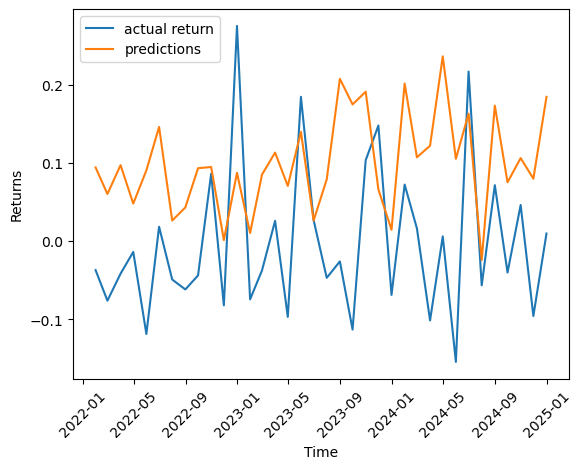

In [19]:
# Test Trial
df, X_train, X_test, y_train, y_test = test_train_split('POOL')

mse, next_month, y_pred = lstm(X_train, X_test, y_train, y_test)
print(mse, next_month)

plt.plot(y_test, label = "actual return")
plt.plot(pd.Series(y_pred.flatten(), index=y_test.index), label = "predictions")
plt.legend() 
plt.xlabel('Time')
plt.ylabel('Returns')
plt.xticks(rotation=45)
plt.show()

In [20]:
dates = y_test.index
dates

DatetimeIndex(['2022-01-31', '2022-02-28', '2022-03-31', '2022-04-30',
               '2022-05-31', '2022-06-30', '2022-07-31', '2022-08-31',
               '2022-09-30', '2022-10-31', '2022-11-30', '2022-12-31',
               '2023-01-31', '2023-02-28', '2023-03-31', '2023-04-30',
               '2023-05-31', '2023-06-30', '2023-07-31', '2023-08-31',
               '2023-09-30', '2023-10-31', '2023-11-30', '2023-12-31',
               '2024-01-31', '2024-02-29', '2024-03-31', '2024-04-30',
               '2024-05-31', '2024-06-30', '2024-07-31', '2024-08-31',
               '2024-09-30', '2024-10-31', '2024-11-30', '2024-12-31'],
              dtype='datetime64[ns]', name='Date', freq='ME')

# Running Model
Performing LSTM and tracking all relevant data 

In [65]:
if os.path.exists('predictions.pkl'):
    with open('predictions.pkl', 'rb') as f:
        preds = pickle.load(f)
else:
    preds = {}

print(pd.DataFrame(preds))

for stock in tickers[300:-1]: 
    print(stock)
    df, X_train, X_test, y_train, y_test = test_train_split(stock)
    mse, next_month_pred, y_pred = lstm(X_train, X_test, y_train, y_test)

    # preds[stock] = (mse, next_month_pred)
    preds[stock] = {
        "mse": mse,
        "next_month_pred": next_month_pred,
        "y_pred": y_pred,
        "y_test": y_test.values,
      
    }

    # Save the predictions to a pickle file
    with open('predictions.pkl', 'wb') as f:
        pickle.dump(preds, f)

                                                              AAPL  \
mse                                                       0.006189   
next_month_pred                                           0.016188   
y_pred           [-0.0015678941, 0.028034959, 0.033382483, -0.0...   
y_test           [-0.0540657004515076, 0.05747318677663493, -0....   

                                                              MSFT  \
mse                                                       0.004926   
next_month_pred                                           0.041839   
y_pred           [0.019019201, 0.008032101, -0.004219761, 0.021...   
y_test           [-0.03721230762712413, 0.031862227363409046, -...   

                                                              NVDA  \
mse                                                       0.032916   
next_month_pred                                           0.063388   
y_pred           [-0.030509861, -0.017842254, 0.038764715, -0.1...   
y_test           [

### Analysis 

In [43]:
with open('predictions.pkl', 'rb') as f:
    preds = pickle.load(f)


preds_df = pd.DataFrame(preds).T
preds_df 

,mse,next_month_pred,y_pred,y_test
AAPL,0.006189,0.016188,"[-0.0015678941, 0.028034959, 0.033382483, -0.0...","[-0.0540657004515076, 0.05747318677663493, -0...."
MSFT,0.004926,0.041839,"[0.019019201, 0.008032101, -0.004219761, 0.021...","[-0.03721230762712413, 0.031862227363409046, -..."
NVDA,0.032916,0.063388,"[-0.030509861, -0.017842254, 0.038764715, -0.1...","[-0.0041248602638329634, 0.11915726251592518, ..."
AMZN,0.012253,-0.001064,"[0.03136919, 0.0024928143, 0.0074099614, 0.011...","[0.026672518265588696, 0.06143728503001622, -0..."
GOOGL,0.00733,-0.035708,"[0.027237542, 0.012997901, 0.017072747, 0.0388...","[-0.001821744401000469, 0.02969469453958462, -..."
...,...,...,...,...
ALB,0.024553,-0.08759,"[0.019086787, 0.043683447, 0.032782257, 0.0130...","[-0.11257569251660104, 0.13128629213424992, -0..."
CRL,0.017409,0.083142,"[0.02281123, 0.020417875, 0.011729054, 0.01066...","[-0.117054842795979, -0.024694334218206326, -0..."
MHK,0.017759,-0.058357,"[0.02262342, -0.0012887181, 0.0037046121, -0.0...","[-0.10825360655268712, -0.1177724248815164, 0...."
IVZ,0.016538,-0.047879,"[0.021370772, -0.021774244, -0.029084438, 0.02...","[-0.055630127631705606, 0.08568725444656589, -..."


Next month month pred represents the prediction for january 2025

In [52]:
next_month = preds_df[['next_month_pred']]

In [53]:
real_ret = pd.DataFrame(returns_mon.iloc[-4])
real_ret.columns = ["Actual"]
real_ret

check = pd.concat((real_ret, next_month), axis=1)[:-1]
check['Residual']  = check['Actual'] - check['next_month_pred']
check['Residual'].values

mse = np.sum((check['Residual'].values)**2)/len(check)

print(f'Mean squared error for predicted January Returns and Actual: {mse}')


Mean squared error for predicted January Returns and Actual: 0.009105191333369143


In [54]:
filtered

,Company Name,Sector
Ticker,,
AAPL,Apple Inc.,Technology
MSFT,Microsoft Corporation,Technology
NVDA,NVIDIA Corporation,Technology
AMZN,"Amazon.com, Inc.",Consumer Discretionary
GOOGL,Alphabet Inc.,Communication Services
...,...,...
ALB,Albemarle Corporation,Materials
CRL,"Charles River Laboratories International, Inc.",Healthcare
MHK,"Mohawk Industries, Inc.",Consumer Discretionary


In [55]:
check

,Actual,next_month_pred,Residual
AAPL,-0.057583,0.016188,-0.073771
MSFT,-0.015279,0.041839,-0.057118
NVDA,-0.105890,0.063388,-0.169279
AMZN,0.083367,-0.001064,0.084432
GOOGL,0.077760,-0.035708,0.113468
...,...,...,...
ALB,-0.021956,-0.08759,0.065634
CRL,-0.107476,0.083142,-0.190618
MHK,0.026610,-0.058357,0.084966
IVZ,0.100114,-0.047879,0.147993


In [56]:
# pd.set_option('display.max_rows', None)
pd.reset_option('display.max_rows')

check = pd.concat([check,merged[:-1][['Sector']]], axis=1).sort_values(by=['Sector','Residual'])
check

,Actual,next_month_pred,Residual,Sector
EA,-0.159877,0.004729,-0.164606,Communication Services
CMCSA,-0.095577,-0.013772,-0.081804,Communication Services
WBD,-0.012299,0.009043,-0.021342,Communication Services
OMC,0.008717,0.0222,-0.013483,Communication Services
VZ,0.002450,0.014507,-0.012057,Communication Services
...,...,...,...,...
AEP,0.066464,0.029482,0.036982,Utilities
CNP,0.026473,-0.018564,0.045037,Utilities
EXC,0.062699,0.012485,0.050215,Utilities
NRG,0.135447,-0.012605,0.148051,Utilities


#### Residual Plot

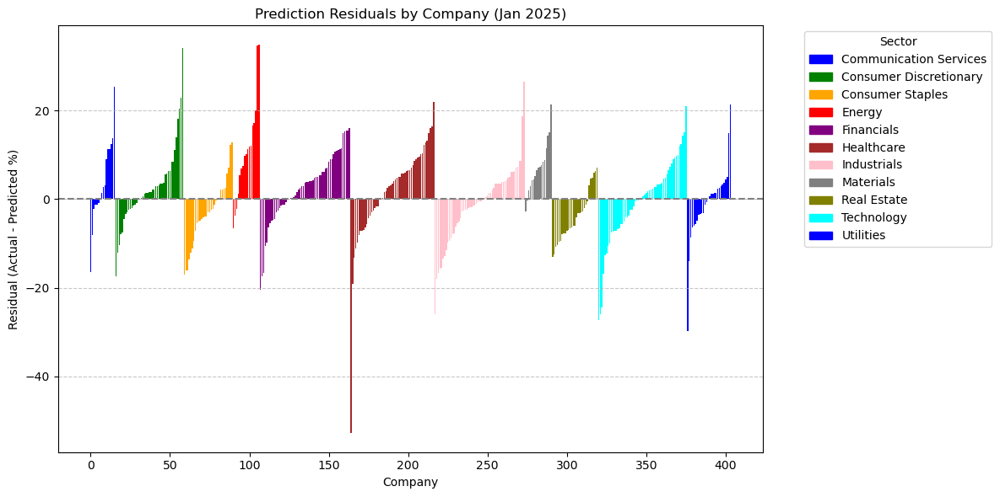

In [ ]:
x = np.arange(len(check))

sectors = check['Sector'].unique()
colors = ['blue', 'green', 'orange', 'red', 'purple', 'brown', 'pink', 'gray', 'olive', 'cyan']
sector_colors = {sector: colors[i % len(colors)] for i, sector in enumerate(sectors)}
bar_colors = check['Sector'].map(sector_colors)

plt.figure(figsize=(12, 6))
plt.bar(x, check['Residual'] * 100, color=bar_colors)
plt.axhline(0, color='gray', linestyle='--')  # line at 0

plt.xlabel("Company")
plt.ylabel("Residual (Actual - Predicted %)")
plt.title("Prediction Residuals by Company (Jan 2025)")
plt.grid(axis='y', linestyle='--', alpha=0.7)

legend_items = []
for sector in sectors:
    legend_items.append(plt.Rectangle((0, 0), 1, 1, color=sector_colors[sector]))
plt.legend(legend_items, sectors, title="Sector", bbox_to_anchor=(1.05, 1), loc='upper left')

plt.tight_layout()
plt.show()


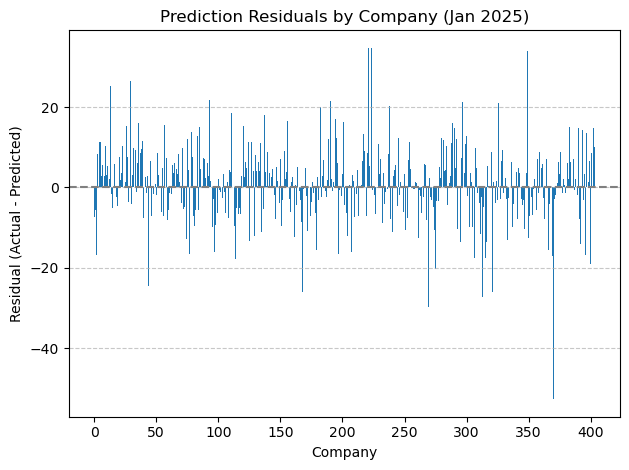

In [25]:
x = np.arange(len(check))  
plt.bar(x, check["Residual"]*100)
plt.axhline(0, color='gray', linestyle='--') 

plt.xlabel("Company")
plt.ylabel("Residual (Actual - Predicted)")
plt.title("Prediction Residuals by Company (Jan 2025)")
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

### An Analysis by Sector 


In [ ]:
final = pd.concat([filtered, preds_df], axis=1)


def calculate_correlation(row):
    return pearsonr(row['y_pred'], row['y_test'])[0]  

final['correlation'] = final.apply(calculate_correlation, axis=1)


# Overall understanding of each sector average 
print('Getting an understanding of each sector')

final[['next_month_pred','mse']] *= 100  # express as percentage
print(final.groupby('Sector')[['next_month_pred','mse', 'correlation']].mean().sort_values(by=['next_month_pred', 'mse'], ascending=[False, True]))


# Finding the best performers for each sector (for those who wish to diversify)
print('\\\n Finding the companies with the highest predicted return next month for each sector')
final.loc[final.groupby('Sector')['next_month_pred'].idxmax()]



Getting an understanding of each sector
                       next_month_pred       mse  correlation
Sector                                                       
Healthcare                    5.338943  1.988176     0.071684
Industrials                   5.098322  1.128614     0.047851
Real Estate                   4.732646  0.871811     0.144222
Technology                    4.202064  1.166204     0.062610
Financials                    2.396682  0.984689     0.053578
Consumer Staples              1.214697  0.739401     0.085742
Utilities                     0.908568  1.191353     0.095321
Consumer Discretionary        0.292168  1.643495    -0.003076
Materials                    -0.956133  1.184347     0.122554
Communication Services       -0.983648   1.60072     0.084792
Energy                       -7.257175  2.076053     0.139920
\
 Finding the companies with the highest predicted return next month for each sector


,Company Name,Sector,mse,next_month_pred,y_pred,y_test,correlation
MTCH,"Match Group, Inc.",Communication Services,2.813225,8.442735,"[-0.011761444, -0.01238469, -0.032205347, -0.0...","[-0.010736531073695321, -0.02466590242942379, ...",0.183849
AZO,"AutoZone, Inc.",Consumer Discretionary,4.4859,16.662882,"[0.056867577, 0.052115764, 0.042985365, 0.0397...","[-0.061902465551786134, 0.0972367244548289, -0...",-0.133878
MDLZ,"Mondelez International, Inc.",Consumer Staples,1.272238,13.268758,"[0.023242375, 0.040304143, 0.052485302, 0.0069...","[-0.02312402546697434, -0.035882855000044955, ...",0.006821
WMB,"The Williams Companies, Inc.",Energy,0.744789,9.004471,"[0.06338254, 0.04615216, 0.057897978, 0.041427...","[0.04475638620209721, 0.08224694192097526, 0.0...",0.167297
ERIE,Erie Indemnity Company,Financials,2.708564,18.491849,"[0.018541446, 0.013053202, -0.015867362, 0.032...","[-0.04888648559937503, 0.005882314986874304, -...",-0.036383
INCY,Incyte Corporation,Healthcare,42.517815,60.09984,"[-0.014718736, -0.020627098, -0.050392885, -0....","[-0.081124695691553, 0.16281104861387474, -0.0...",0.049293
FAST,Fastenal Company,Industrials,1.664463,28.372473,"[0.07873089, 0.056280084, 0.025324013, 0.06551...","[-0.08710301230814788, 0.15429458553137354, -0...",0.076526
NEM,Newmont Corporation,Materials,1.548918,5.937118,"[0.020536616, 0.0353379, 0.01126776, 0.0501765...","[0.08223001252679851, 0.20871698351687273, -0....",-0.072618
AMT,American Tower Corporation,Real Estate,1.114381,10.319109,"[0.028151676, 0.043861523, -0.02323421, 0.0190...","[-0.0979323492829639, 0.10733011762764644, -0....",0.101627
GEN,Gen Digital Inc.,Technology,2.878732,24.2348,"[0.017030763, -0.013003627, 0.019050885, 0.017...","[0.1191492801675289, -0.08488600604463248, -0....",0.346688


In [210]:
final.loc[final['correlation'].idxmax()]

Company Name                        Occidental Petroleum Corporation
Sector                                                        Energy
mse                                                         0.020752
next_month_pred                                             -0.12471
y_pred             [-0.0022159792, 0.0022815075, -0.017838296, 0....
y_test             [0.1608709620019808, 0.30060396606778506, -0.0...
correlation                                                 0.484772
Name: OXY, dtype: object

The company with the lowest MSE 
Company Name                                       Johnson & Johnson
Sector                                                    Healthcare
mse                                                          0.20918
next_month_pred                                            -0.637741
y_pred             [0.02105787, 0.01667257, 0.013712689, 0.019497...
y_test             [-0.03867649958975372, 0.0769278071328725, 0.0...
correlation                                                 0.135167
Name: JNJ, dtype: object


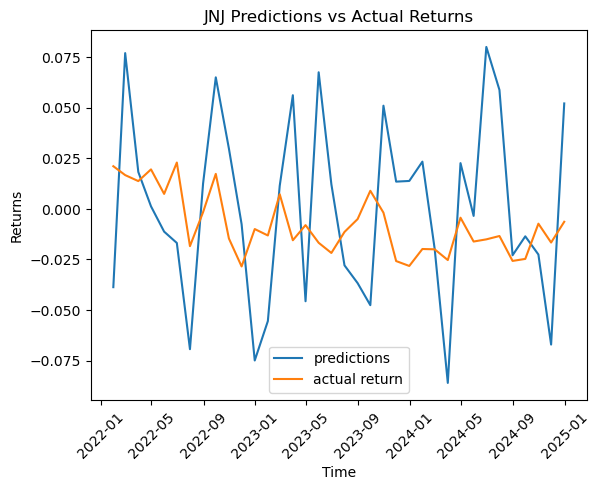

In [251]:
def plot_pred(stock): 
    ypred = preds_df.loc[stock]['y_pred']
    ytest = preds_df.loc[stock]['y_test']

    plt.plot(dates, ytest, label = "predictions")
    plt.plot(dates, ypred , label = "actual return")
    plt.legend() 
    plt.xlabel('Time')
    plt.ylabel('Returns')
    plt.xticks(rotation=45)
    plt.title(f'{stock} Predictions vs Actual Returns')
    plt.show()


# The company with lowest mse 
print(f"The company with the lowest MSE \n{final.loc[final['mse'].idxmin()]}")

plot_pred('JNJ')



Doesn't do the greatest job at capturing the trend upward or downwards despite having the lowest mean squared error. 

In [ ]:
# Sorting by next month prediction 
# pd.set_option('display.max_rows', None)
# pd.reset_option('display.max_rows')

final.sort_values(by='next_month_pred', ascending = False)


,Company Name,Sector,mse,next_month_pred,y_pred,y_test,correlation
INCY,Incyte Corporation,Healthcare,42.517815,60.09984,"[-0.014718736, -0.020627098, -0.050392885, -0....","[-0.081124695691553, 0.16281104861387474, -0.0...",0.049293
FAST,Fastenal Company,Industrials,1.664463,28.372473,"[0.07873089, 0.056280084, 0.025324013, 0.06551...","[-0.08710301230814788, 0.15429458553137354, -0...",0.076526
BLDR,"Builders FirstSource, Inc.",Industrials,8.058737,26.835716,"[0.04606988, 0.056170516, 0.058864575, 0.01785...","[0.0945727387440054, -0.13275997710976561, -0....",0.010454
GEN,Gen Digital Inc.,Technology,2.878732,24.2348,"[0.017030763, -0.013003627, 0.019050885, 0.017...","[0.1191492801675289, -0.08488600604463248, -0....",0.346688
DXCM,"DexCom, Inc.",Healthcare,9.908139,22.832015,"[-0.024519041, -0.017872967, -0.034934692, -0....","[-0.03849193203246071, 0.23601749553546503, -0...",-0.117905
...,...,...,...,...,...,...,...
VTRS,Viatris Inc.,Healthcare,5.848691,-16.481668,"[0.036947988, 0.017304616, 0.03795574, 0.02014...","[-0.25841274500989897, -0.011807517795742628, ...",-0.213278
TPL,Texas Pacific Land Corporation,Energy,2.988215,-17.480917,"[0.0056953155, 0.067628585, 0.0060923025, 0.08...","[0.10579554349807574, 0.14007334756065526, 0.0...",0.173831
EQT,EQT Corporation,Energy,8.373199,-23.789038,"[0.060322568, 0.016813334, -0.053535238, 0.033...","[0.09525879400744341, 0.4870356158281359, 0.15...",0.297630
RL,Ralph Lauren Corporation,Consumer Discretionary,10.233311,-26.008391,"[0.042842917, -0.004170765, 0.02484272, 0.0712...","[0.19126643000436583, -0.13590053175595107, -0...",-0.170383


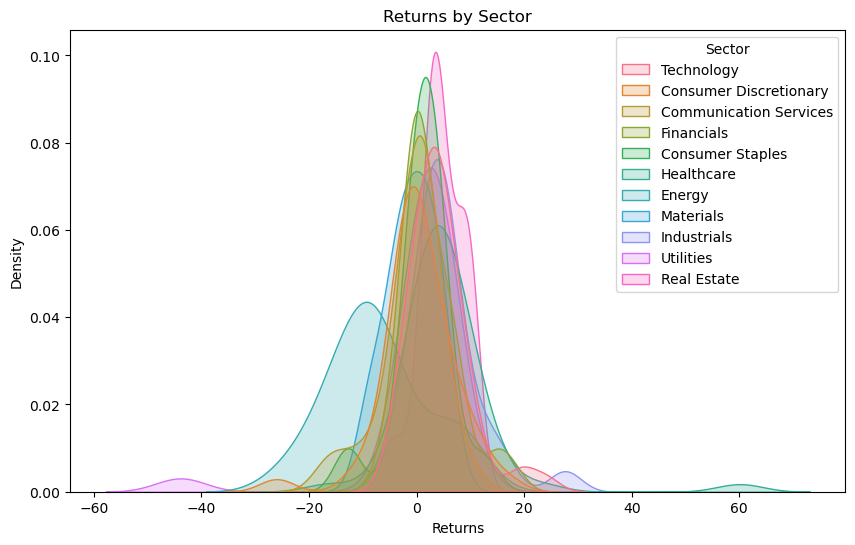

In [ ]:
# Understanding the distribution for the predictions 
plt.figure(figsize=(10, 6))
sns.kdeplot(data=final, x='next_month_pred', hue='Sector', fill=True, common_norm=False)
plt.title('Returns by Sector')
plt.xlabel('Returns')
plt.ylabel('Density')
plt.show()

### Comparing all predictions and actual returns 

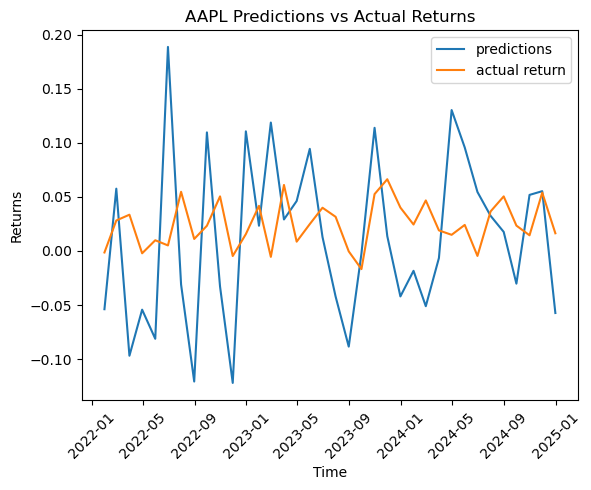

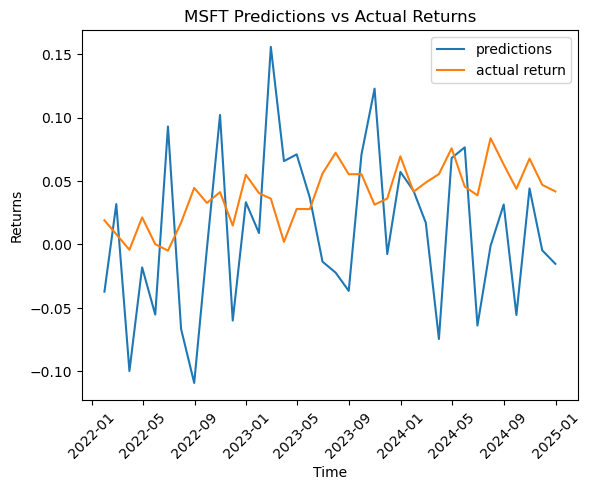

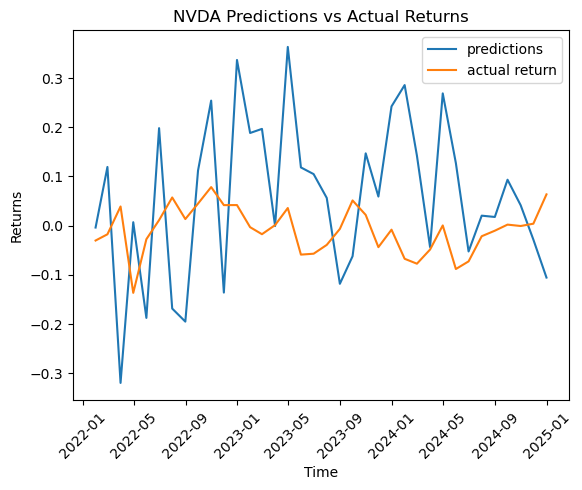

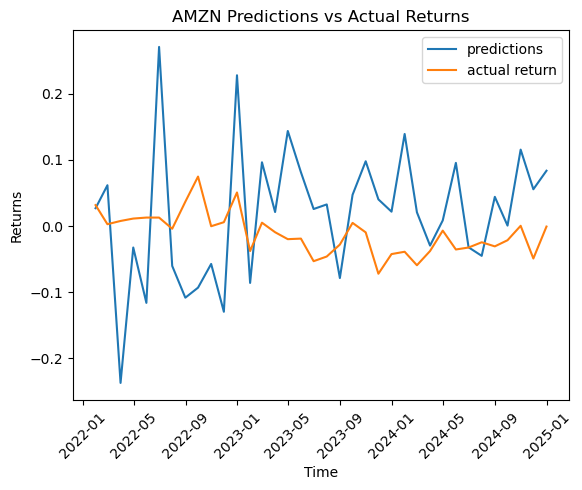

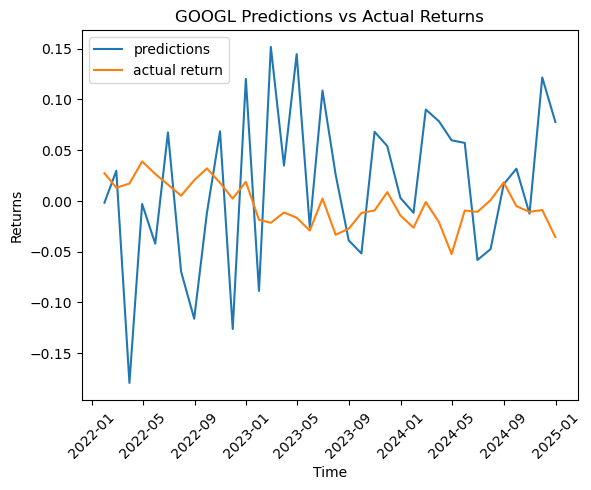

...

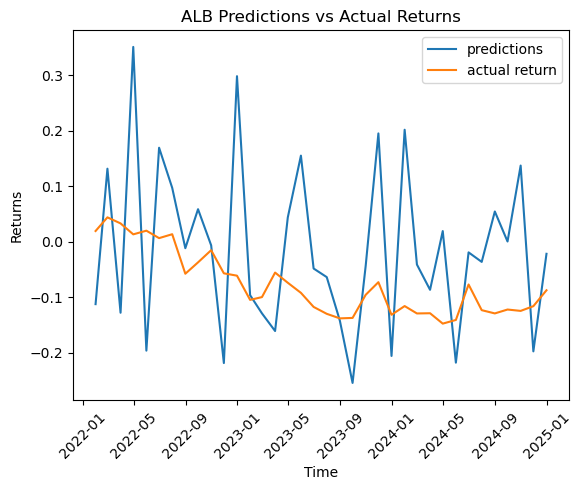

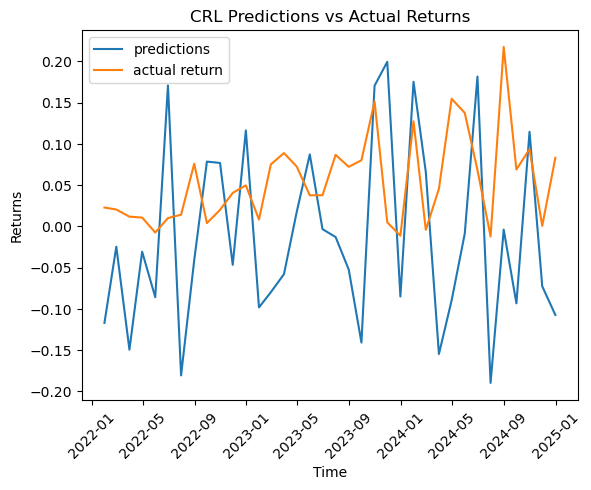

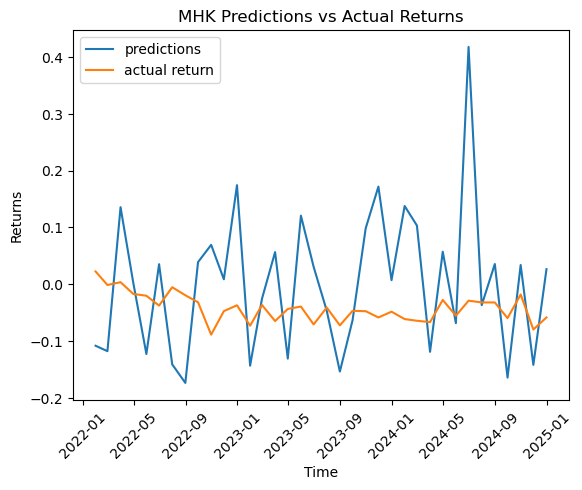

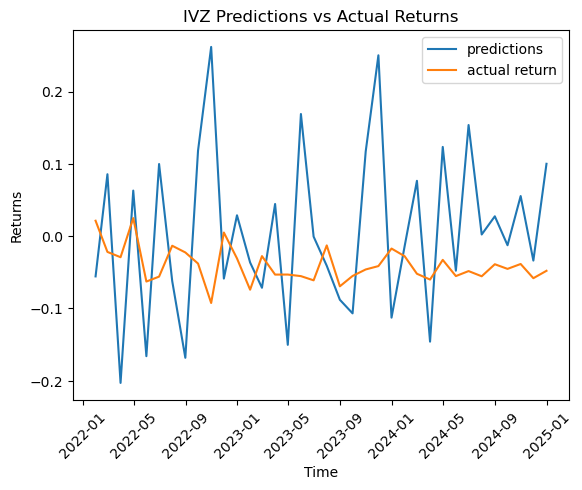

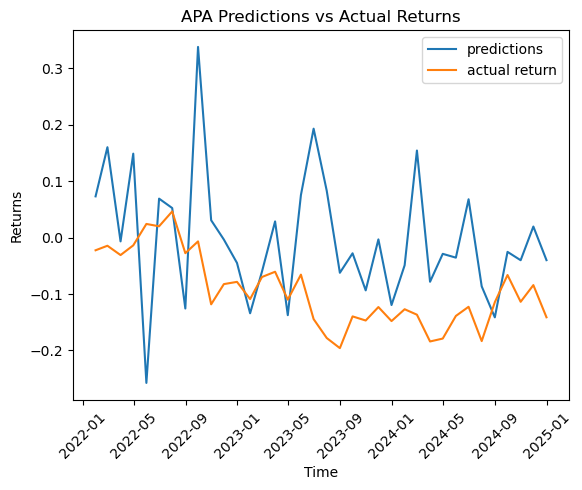

In [185]:
for stock in tickers[:-1]:
    plot_pred(stock)